![US bevereages market share](./images/unknown.png)

# Background

We need to identify store with anomaly in reporting sales per transaction between 2020 to the end 2020 in Des Moines, Polk.

Why is this a problem:

1. According to the data published by Beverage Information Group, Park Street Analyses in 2016, Liquor is the 4th most popular beverages in the states.

  Therefore, it will be an anomaly if a store did not sell lots of liquor per trasactin (in sales dollars or in volumes).

  For the IRS, it could be an opportunity to increase tax revenue by investigating whether a store correctly reported its liquor sales.

Why is there has to be a solution NOW:
1. A store with bad faith can falsify its liquor sales.



# Dataset Overview

This dataset contains sale made by store of liquor in Des Moines, Polk. There are features that will be included for anomaly segmentation.

bigquery-public-data.iowa_liquor_sales.sales

```
# Which city has the highest sale in dollars?
SELECT city, SUM(sale_dollars) AS a FROM bigquery-public-data.iowa_liquor_sales.sales
WHERE date BETWEEN '2020-01-01' AND '2020-12-31'
GROUP BY city
ORDER BY a DESC;

# Get data set
SELECT * FROM bigquery-public-data.iowa_liquor_sales.sales
WHERE CITY='DES MOINES'
AND date BETWEEN '2020-01-01' AND '2020-12-31';
```

# Target Market

The Internal Revenue Service, this model can give the IRS list of store to investigate.

# Import Library

In [31]:
# Import libraries
import pandas as pd
import numpy as np
from statsmodels.stats.outliers_influence import variance_inflation_factor
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Scaling
from sklearn.preprocessing import RobustScaler

# Outliers handling
from feature_engine.outliers import Winsorizer

# PCA
from sklearn.decomposition import PCA


# 
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from matplotlib.colors import ListedColormap

# Ignore the warning notes
import warnings
warnings.filterwarnings("ignore")

from sklearn.metrics import silhouette_score

# Functions

In [55]:
# 3D scatter plot
def plot_scatter3d(x, y, z, labels=None):
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')

    cmap = ListedColormap(sns.color_palette("tab10").as_hex())

    if labels is None:
        ax.scatter(xs=x, ys=y, zs=z)
    else:
        sc = ax.scatter(xs=x, ys=y, zs=z, c=labels, cmap=cmap)
        plt.legend(*sc.legend_elements(), bbox_to_anchor=(1.05, 1), loc=2)

# Data Loading

In [2]:
dt = pd.read_csv("./raw.csv")
dt

,invoice_and_item_number,date,store_number,store_name,address,city,zip_code,store_location,county_number,county,...,item_number,item_description,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,volume_sold_gallons
0,INV-28785300009,2020-07-17,4803,WALGREENS #07453 / DES MOINES,104 E EUCLID AVE,DES MOINES,50313.0,POINT(-93.617218 41.627683),77,POLK,...,38176,TITOS HANDMADE VODKA,12,750,10.00,15.00,24,360.00,18.00,4.75
1,INV-32811300054,2020-12-17,4802,WALGREENS #07452 / DES MOINES,4415 DOUGLAS AVE,DES MOINES,50310.0,POINT(-93.678747 41.62949),77,POLK,...,52596,E & J VS,12,750,6.50,9.75,24,234.00,18.00,4.75
2,INV-28951400006,2020-07-24,5970,KUM & GO #7701 / DES MOINES,319 7TH ST STE 101,DES MOINES,50309.0,POINT(-93.626017 41.586367),77,POLK,...,11294,CROWN ROYAL,24,375,8.00,12.00,1,12.00,0.37,0.09
3,INV-32989100014,2020-12-24,5375,CASEY'S GENERAL STORE # 3518/ DES MOINES,1907 ARMY POST RD,DES MOINES,50315.0,POINT(-93.641742 41.526539),77,POLK,...,38178,TITOS HANDMADE VODKA,6,1750,19.00,28.50,3,85.50,5.25,1.38
4,INV-32827900058,2020-12-18,6064,CASEY'S GENERAL STORE #2676 / DES MOINES,2106 ECHO VALLEY DR,DES MOINES,50321.0,NaN,77,POLK,...,45888,SAILOR JERRY SPICED NAVY RUM,6,1750,19.25,28.88,3,86.64,5.25,1.38
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209822,INV-32093400026,2020-11-20,5676,FAMILY PANTRY,4538 LOWER BEAVER RD,DES MOINES,50310.0,POINT(-93.665871 41.638673),77,POLK,...,5346,JOHNNIE WALKER RED,12,750,13.50,20.25,2,40.50,1.50,0.39
209823,INV-24604700028,2020-01-16,5676,FAMILY PANTRY,4538 LOWER BEAVER RD,DES MOINES,50310.0,POINT(-93.665871 41.638673),77,POLK,...,34030,ABSOLUT CITRON,12,750,9.99,14.99,2,29.98,1.50,0.39
209824,INV-32399800019,2020-12-03,5676,FAMILY PANTRY,4538 LOWER BEAVER RD,DES MOINES,50310.0,POINT(-93.665871 41.638673),77,POLK,...,52316,CHRISTIAN BROS BRANDY,12,750,6.00,9.00,2,18.00,1.50,0.39
209825,INV-29963900032,2020-09-03,5676,FAMILY PANTRY,4538 LOWER BEAVER RD,DES MOINES,50310.0,POINT(-93.665871 41.638673),77,POLK,...,64913,CIROC MANGO,12,375,9.25,13.88,4,55.52,1.50,0.39


- 'store_location' will be dropped. (we will use store_number for identifier)
- 'category', 'category_name' will be dropped. (nominal fetures)

In [3]:
dt.isna().sum()

invoice_and_item_number        0
date                           0
store_number                   0
store_name                     0
address                        0
city                           0
zip_code                       0
store_location             22088
county_number                  0
county                         0
category                      53
category_name                 53
vendor_number                  0
vendor_name                    0
item_number                    0
item_description               0
pack                           0
bottle_volume_ml               0
state_bottle_cost              0
state_bottle_retail            0
bottles_sold                   0
sale_dollars                   0
volume_sold_liters             0
volume_sold_gallons            0
dtype: int64

- features unrelated to Clustering will be dropped:
  - 'invoice_and_item_number', etc.
- features that are duplicated:
  - 'volume_sold_gallons' -> duplicate of 'volume_sold_liters'

In [4]:
dt.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 209827 entries, 0 to 209826
Data columns (total 24 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   invoice_and_item_number  209827 non-null  object 
 1   date                     209827 non-null  object 
 2   store_number             209827 non-null  int64  
 3   store_name               209827 non-null  object 
 4   address                  209827 non-null  object 
 5   city                     209827 non-null  object 
 6   zip_code                 209827 non-null  float64
 7   store_location           187739 non-null  object 
 8   county_number            209827 non-null  int64  
 9   county                   209827 non-null  object 
 10  category                 209774 non-null  float64
 11  category_name            209774 non-null  object 
 12  vendor_number            209827 non-null  float64
 13  vendor_name              209827 non-null  object 
 14  item

In [5]:
# Split data inference dan data biasa
data_inf = dt.sample(10, random_state = 1) # 10 rows as inference model

# Menghapus Inference Model dari dataset
dt = dt.drop(data_inf.index)

# Reset index untuk kedua dataset
dt.reset_index(drop = True , inplace = True)
data_inf.reset_index(drop = True , inplace = True)

# Data Preprocessing

In [6]:
dt_processed = dt.copy()
dt_processed.drop(['invoice_and_item_number', 'date',
                   'store_name', 'address', 'city',
                   'zip_code', 'store_location',
                   'county_number', 'county',
                   'category', 'category_name',
                   'vendor_number', 'vendor_name',
                   'item_number', 'item_description',
                   'volume_sold_gallons'], axis=1, errors='ignore', inplace=True)

In [57]:
dt_processed

,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,4803,12,750,10.00,15.00,24,360.00,18.00,7
1,4802,12,750,6.50,9.75,24,234.00,18.00,12
2,5970,24,375,8.00,12.00,1,12.00,0.37,7
3,5375,6,1750,19.00,28.50,3,85.50,5.25,12
4,6064,6,1750,19.25,28.88,3,86.64,5.25,12
...,...,...,...,...,...,...,...,...,...
209812,5676,12,750,13.50,20.25,2,40.50,1.50,11
209813,5676,12,750,9.99,14.99,2,29.98,1.50,1
209814,5676,12,750,6.00,9.00,2,18.00,1.50,12
209815,5676,12,375,9.25,13.88,4,55.52,1.50,9


In [7]:
dt_processed['month'] = pd.DatetimeIndex(dt['date']).month
dt_processed.groupby(['store_number', 'month']).sum()

pack  bottle_volume_ml  state_bottle_cost  \
store_number month                                               
2190         1      12412            882625           18453.91   
             2      14013            943250           18067.45   
             3      16362           1120525           20622.05   
             4      20529           1468225           25428.27   
             5      19282           1328275           26378.91   
...                   ...               ...                ...   
6057         9       1125             43900             675.40   
             10      2530            137975            1751.66   
             11      2028             92500            1252.13   
             12      4067            178225            2467.79   
6064         12      1196             55500             798.08   

                    state_bottle_retail  bottles_sold  sale_dollars  \
store_number month                                                    
2190         1                 27683.14          9659     172828.23   
             2                 27103.59          9643     170931.72   
             3                 30935.87         12453     199854.27   
             4                 38145.95         14199     216056.20   
             5                 39571.72         13864     232919.42   
...                                 ...           ...           ...   
6057         9                  1013.23           985       9482.69   
             10                 2627.88          1312      14028.82   
             11                 1878.52           923       8880.67   
             12                 3702.25          1788      16896.05   
6064         12                 1197.36           839       9563.70   

                    volume_sold_liters  
store_number month                      
2190         1                 6702.29  
             2                 6516.16  
             3                 7920.78  
             4                 9591.97  
             5                 9231.89  
...                                ...  
6057         9                  445.50  
             10                 762.19  
             11                 517.47  
             12                 930.30  
6064         12                 444.07  

[937 rows x 7 columns]

## Multicollinearity Test

In [8]:
def isolate():
    # the independent variables set
    X = dt_processed[['pack', 'bottle_volume_ml', 'state_bottle_cost', 'state_bottle_retail',
                      'bottles_sold', 'sale_dollars', 'volume_sold_liters']]

    # VIF dataframe
    vif_data = pd.DataFrame()
    vif_data["feature"] = X.columns

    # calculating VIF for each feature
    vif_data["VIF"] = [variance_inflation_factor(X.values, i)
                            for i in range(len(X.columns))]

    display(vif_data.sort_values(by='VIF', ascending=False)
                    .style.background_gradient(cmap="coolwarm"))
isolate()

,feature,VIF
3,state_bottle_retail,134838.814058
2,state_bottle_cost,134828.723630
6,volume_sold_liters,9.796467
4,bottles_sold,7.054820
5,sale_dollars,6.248461
1,bottle_volume_ml,2.199804
0,pack,1.914907


- Multicollinearity friendly.
- Outliers nemesis.

In [9]:
def Skew_LLUL(df, variable, multiplier = 1.5):
    Q1 = df[variable].quantile(0.25)
    Q3 = df[variable].quantile(0.75)
    IQR = Q3 - Q1
    LL = Q1 - multiplier * IQR
    UL = Q3 + multiplier * IQR
    return LL, UL

In [10]:
# Show Outliers 5 head and 5 tail V2
def Show_LLUL(df, variable, LL, UL):
    out_df = df[(df[variable] > UL) | (df[variable] < LL)]
    out_df.sort_values(variable, ascending = False, inplace = True)
    out_df.reset_index(inplace = True)
    print(out_df.shape[0] / df.shape[0] * 100, '% is considered as outliers')
    return out_df.iloc[np.r_[0:6, -6:-1]]

In [11]:
features = ['state_bottle_retail', 'state_bottle_cost', 'volume_sold_liters', 
            'bottles_sold', 'sale_dollars']

In [12]:
state_bottle_retail_LL, state_bottle_retail_UL = Skew_LLUL(dt_processed, "state_bottle_retail",3)
Show_LLUL(dt_processed, "state_bottle_retail", state_bottle_retail_LL, state_bottle_retail_UL)

1.567079883898826 % is considered as outliers


,index,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,155579,4829,1,750,1749.12,2623.68,1,2623.68,0.75,8
1,39257,2527,1,750,1250.00,1875.00,1,1875.00,0.75,2
2,106595,4169,1,750,1000.00,1500.00,1,1500.00,0.75,3
3,31813,2248,3,750,549.99,824.99,1,824.99,0.75,12
4,76573,2633,3,750,549.99,824.99,1,824.99,0.75,12
5,150185,4829,4,750,499.99,749.99,1,749.99,0.75,11
3282,163633,5098,6,750,38.88,58.32,1,58.32,0.75,7
3283,93588,2673,6,750,38.88,58.32,6,349.92,4.50,9
3284,16175,2190,6,750,38.88,58.32,6,349.92,4.50,7
3285,20150,2190,6,750,38.88,58.32,2,116.64,1.50,12


In [13]:
state_bottle_cost_LL, state_bottle_cost_UL = Skew_LLUL(dt_processed, "state_bottle_cost",3)
Show_LLUL(dt_processed, "state_bottle_cost", state_bottle_cost_LL, state_bottle_cost_UL)

1.567079883898826 % is considered as outliers


,index,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,155579,4829,1,750,1749.12,2623.68,1,2623.68,0.75,8
1,39257,2527,1,750,1250.00,1875.00,1,1875.00,0.75,2
2,106595,4169,1,750,1000.00,1500.00,1,1500.00,0.75,3
3,31813,2248,3,750,549.99,824.99,1,824.99,0.75,12
4,76573,2633,3,750,549.99,824.99,1,824.99,0.75,12
5,150185,4829,4,750,499.99,749.99,1,749.99,0.75,11
3282,163633,5098,6,750,38.88,58.32,1,58.32,0.75,7
3283,93588,2673,6,750,38.88,58.32,6,349.92,4.50,9
3284,16175,2190,6,750,38.88,58.32,6,349.92,4.50,7
3285,20150,2190,6,750,38.88,58.32,2,116.64,1.50,12


In [14]:
volume_sold_liters_LL, volume_sold_liters_UL = Skew_LLUL(dt_processed, "volume_sold_liters",3)
Show_LLUL(dt_processed, "volume_sold_liters", volume_sold_liters_LL, volume_sold_liters_UL)

4.3209082200203035 % is considered as outliers


,index,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,79012,2633,12,1000,12.67,19.01,13200,250932.00,13200.0,10
1,76286,2633,12,1000,12.67,19.01,3960,75279.60,3960.0,6
2,79523,2633,12,1000,12.67,19.01,2700,51327.00,2700.0,1
3,72663,2633,6,1750,15.33,23.00,1440,33120.00,2520.0,12
4,198865,5533,6,1750,13.50,20.25,1200,24300.00,2100.0,9
5,94097,3678,6,1750,10.45,15.68,1182,18533.76,2068.5,12
9060,83441,2633,12,1000,15.16,22.74,36,818.64,36.0,10
9061,83440,2633,12,1000,12.49,18.74,36,674.64,36.0,1
9062,83439,2633,12,1000,4.38,6.57,36,236.52,36.0,2
9063,8239,4343,44,200,4.72,7.08,176,1246.08,35.2,10


In [15]:
bottles_sold_LL, bottles_sold_UL = Skew_LLUL(dt_processed, "bottles_sold",3)
Show_LLUL(dt_processed, "bottles_sold", bottles_sold_LL, bottles_sold_UL)

7.029459004751761 % is considered as outliers


,index,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,79012,2633,12,1000,12.67,19.01,13200,250932.00,13200.0,10
1,76286,2633,12,1000,12.67,19.01,3960,75279.60,3960.0,6
2,79523,2633,12,1000,12.67,19.01,2700,51327.00,2700.0,1
3,84563,2633,12,750,15.59,23.39,2016,47154.24,1512.0,9
4,81232,2633,12,1000,3.97,5.96,1980,11800.80,1980.0,12
5,72663,2633,6,1750,15.33,23.00,1440,33120.00,2520.0,12
14743,58503,2561,8,100,6.00,9.00,40,360.00,4.0,10
14744,58502,2561,8,100,6.00,9.00,40,360.00,4.0,7
14745,86623,2636,8,100,6.00,9.00,40,360.00,4.0,11
14746,56052,2561,8,100,6.00,9.00,40,360.00,4.0,9


In [16]:
sale_dollars_LL, sale_dollars_UL = Skew_LLUL(dt_processed, "sale_dollars",3)
Show_LLUL(dt_processed, "sale_dollars", sale_dollars_LL, sale_dollars_UL)

4.720303883860698 % is considered as outliers


,index,store_number,pack,bottle_volume_ml,state_bottle_cost,state_bottle_retail,bottles_sold,sale_dollars,volume_sold_liters,month
0,79012,2633,12,1000,12.67,19.01,13200,250932.00,13200.0,10
1,76286,2633,12,1000,12.67,19.01,3960,75279.60,3960.0,6
2,79523,2633,12,1000,12.67,19.01,2700,51327.00,2700.0,1
3,84563,2633,12,750,15.59,23.39,2016,47154.24,1512.0,9
4,72663,2633,6,1750,15.33,23.00,1440,33120.00,2520.0,12
5,72860,2633,12,750,15.59,23.39,1344,31436.16,1008.0,7
9898,146334,4829,6,1000,21.67,32.51,18,585.18,18.0,7
9899,149576,4829,6,1000,21.67,32.51,18,585.18,18.0,8
9900,149059,4829,6,1000,21.67,32.51,18,585.18,18.0,8
9901,156031,4829,6,1000,21.67,32.51,18,585.18,18.0,1


In [17]:
df_processed_1 = dt_processed.loc[(dt_processed['state_bottle_retail'] < state_bottle_retail_UL) & (dt_processed['state_bottle_retail'] > state_bottle_retail_LL)]
df_processed_1 = df_processed_1.loc[(df_processed_1['state_bottle_cost'] < state_bottle_cost_UL) & (df_processed_1['state_bottle_cost'] > state_bottle_cost_LL)]
df_processed_1 = df_processed_1.loc[(df_processed_1['volume_sold_liters'] < volume_sold_liters_UL) & (df_processed_1['volume_sold_liters'] > volume_sold_liters_LL)]
df_processed_1 = df_processed_1.loc[(df_processed_1['bottles_sold'] < bottles_sold_UL) & (df_processed_1['bottles_sold'] > bottles_sold_LL)]
df_processed_1 = df_processed_1.loc[(df_processed_1['sale_dollars'] < sale_dollars_UL) & (df_processed_1['sale_dollars'] > sale_dollars_LL)]

In [18]:
yes = dt_processed[features]

In [19]:
#winsoriser = Winsorizer(capping_method='iqr', tail = 'both', fold = 3)
#dt_processed_capped = winsoriser.fit_transform(yes)

Statement :<br>
Biggest failure feature in human history!

In [20]:
dt_processed_capped = np.log10(yes + 10**-10)

In [21]:
# Defining scaler using robust scaler
scaler = RobustScaler()
dt_processed_scaled = pd.DataFrame(scaler.fit_transform(dt_processed_capped), columns = features)

In [22]:
# Defining PCA model
PCA_Reducer = PCA(n_components = 3, random_state = 1)

In [23]:
# Transformasi data ke dimensi yang lebih kecil
reduced_data = PCA_Reducer.fit_transform(dt_processed_scaled)
RD_DF = pd.DataFrame(reduced_data, columns = ['V1','V2','V3'])

In [69]:
x, y, z = reduced_data.T

fig = px.scatter_3d(x=x, y=y, z=z)
fig.update_traces(marker_size=3)
fig.show()

# plot_scatter3d(x=x,y=y,z=z)

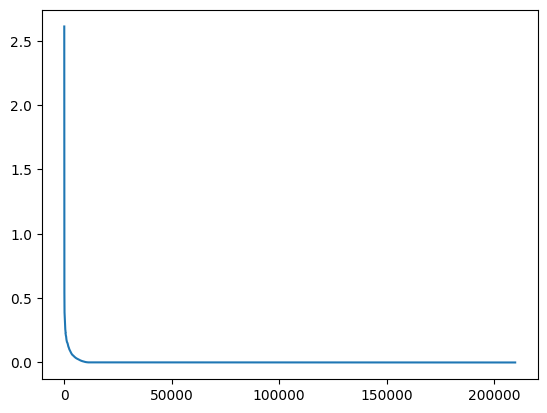

In [26]:
# predicting epsilon for DBSCAN
def isolate():
    X_train_final = dt_processed_scaled

    neigh = NearestNeighbors(n_neighbors=6)
    neigh.fit(X=X_train_final)

    distances, apakek = neigh.kneighbors(X=X_train_final)

    distances = np.sort(distances, axis=0)

    farthest_distances = distances[:,-1]
    farthest_distances[::-1].sort() # hack.

    sns.lineplot(x=range(0, len(farthest_distances)), y=farthest_distances)

    # fig = px.line(y=farthest_distances)
    # fig.show()

isolate()

- Due to time constraints, we guess `eps=0.6`. The expected cluster should be 7 but, the actual clusters are 3 and -1 (outlier). We will try our best to explain the clusters.

In [27]:
dbscan_list = [DBSCAN(eps=i, min_samples=6, n_jobs=-1) for i in [0.6]]

In [28]:
for dbscan in dbscan_list:
    dbscan.fit(reduced_data)
    print(dbscan, "done")

DBSCAN(eps=0.6, min_samples=6, n_jobs=-1) done


In [29]:
for dbscan in dbscan_list:
    print(np.unique(dbscan.labels_).shape)

(4,)


In [67]:
x, y, z = reduced_data.T

# plot_scatter3d(x=x,y=y,z=z, labels=dbscan_list[0].labels_)

fig = px.scatter_3d(x=x, y=y, z=z, color=dbscan_list[0].labels_)
fig.update_traces(marker_size=3)
fig.show()

In [47]:
yes_1 = yes.copy()
yes_1['label'] = dbscan_list[0].labels_

- Profit Margin between clusters are the same.
- Label -1 are outliers (selling for about 800 bottles on average per transaction)
- Label 1, 2 only sold between 2 - 15 bottles on average per transaction.  

<AxesSubplot: xlabel='label'>

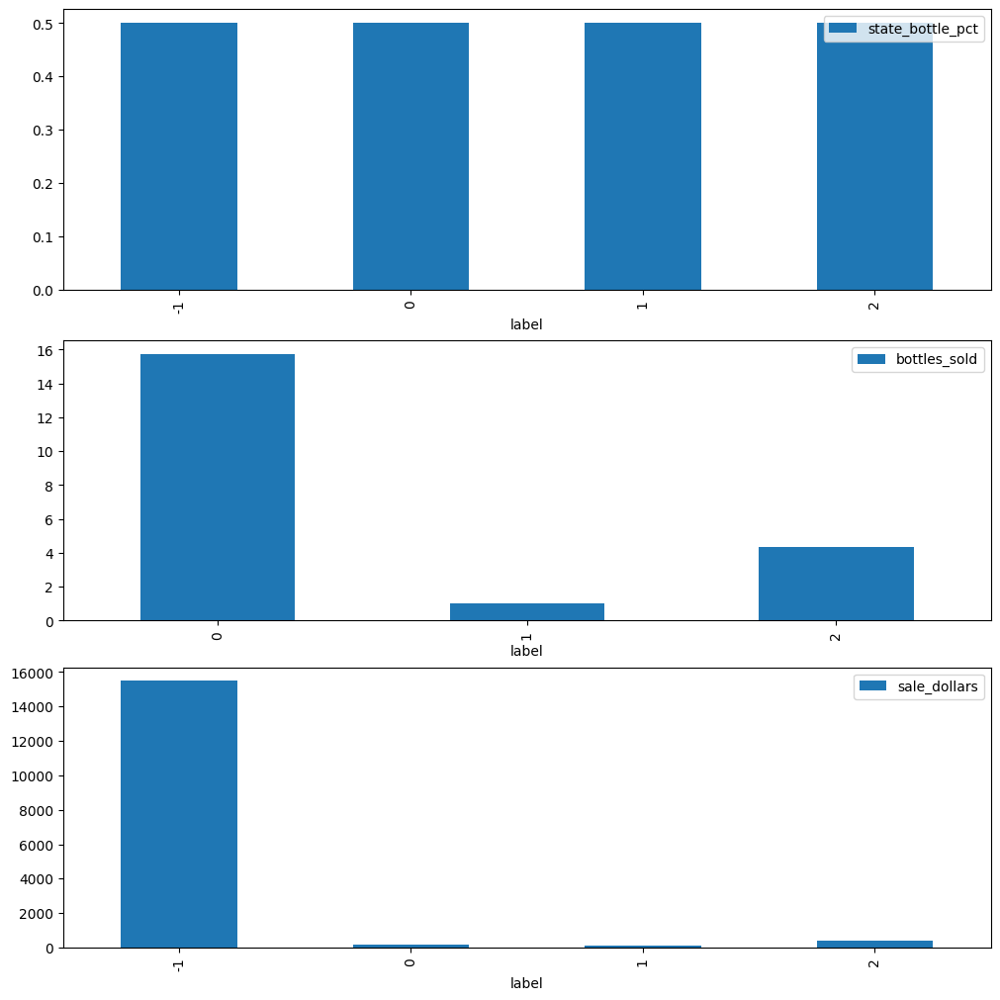

In [66]:
fig, axes = plt.subplots(3,1, layout="constrained", figsize=(10,10))
interests = ['state_bottle_pct', 'label']
yes_1['state_bottle_pct'] = (yes_1['state_bottle_retail'] - yes_1['state_bottle_cost']) / yes_1['state_bottle_cost']
yes_1[interests].groupby('label').mean().plot.bar(ax=axes[0])
yes_1.loc[yes_1['label'] != -1,['bottles_sold', 'label']].groupby('label').mean().plot.bar(ax=axes[1])
yes_1[['sale_dollars', 'label']].groupby('label').mean().plot.bar(ax=axes[2])